In [16]:
import pickle
from pathlib import Path
import numpy as np
from sklearn.neighbors import KNeighborsClassifier
import os
import ml_metrics as metrics
import umap.umap_ as umap

data_path = Path('C:/Users/rachi/OneDrive/Documentos/Datasets/flickr30k')
feature_path = Path("./results")

C:\Users\rachi\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.8_qbz5n2kfra8p0\LocalCache\local-packages\Python38\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [5]:
def apk(actual, predicted, k=10):
    """
    Computes the average precision at k.
    This function computes the average prescision at k between two lists of
    items.
    Parameters
    ----------
    actual : list
             A list of elements that are to be predicted (order doesn't matter)
    predicted : list
                A list of predicted elements (order does matter)
    k : int, optional
        The maximum number of predicted elements
    Returns
    -------
    score : double
            The average precision at k over the input lists
    """
    if len(predicted) > k:
        predicted = predicted[:k]

    score = 0.0
    num_hits = 0.0

    for i, p in enumerate(predicted):
        if p in actual and p not in predicted[:i]:
            num_hits += 1.0
            score += num_hits / (i + 1.0)

    if not actual:
        return 0.0

    return score / min(len(actual), k)


def mapk(actual, predicted, k=10):
    """
    Computes the mean average precision at k.
    This function computes the mean average prescision at k between two lists
    of lists of items.
    Parameters
    ----------
    actual : list
             A list of lists of elements that are to be predicted
             (order doesn't matter in the lists)
    predicted : list
                A list of lists of predicted elements
                (order matters in the lists)
    k : int, optional
        The maximum number of predicted elements
    Returns
    -------
    score : double
            The mean average precision at k over the input lists
    """
    return np.mean([apk(a, p, k) for a, p in zip(actual, predicted)])


def pk(actual, predicted, k=10):
    """
    Computes the precision at k.
    This function computes the precision at k between the query image and a list
    of database retrieved images.
    Parameters
    ----------
    actual : int
             The element that has to be predicted
    predicted : list
                A list of predicted elements (order does matter)
    k : int, optional
        The maximum number of predicted elements
    Returns
    -------
    score : double
            The precision at k over the input
    """
    if len(predicted) > k:
        predicted = predicted[:k]
    score = 0
    for i in range(len(predicted)):
        if actual == predicted[i]:
            score += 1
    
    return score / len(predicted)

def mpk(actual, predicted, k=10):
    """
    Computes the precision at k.
    This function computes the mean precision at k between a list of query images and a list
    of database retrieved images.
    Parameters
    ----------
    actual : list
             The query elements that have to be predicted
    predicted : list
                A list of predicted elements (order does matter) for each query element
    k : int, optional
        The maximum number of predicted elements
    Returns
    -------
    score : double
            The precision at k over the input
    """
    pk_list = []
    for i in range(len(actual)):
        score = pk(actual[i], predicted[i], k)
        pk_list.append(score)
    return np.mean(pk_list)

def AP(actual, predicted):
    """
    Computes the precision at k.
    This function computes the average precision precision between the query image and a list
    of database retrieved images.
    Parameters
    ----------
    actual : int
             The element that has to be predicted
    predicted : list
                A list of predicted elements (order does matter)
    Returns
    -------
    score : double
            The Average Precision over the input
    """
    gtp = 0
    ap = 0
    for i in range(len(predicted)):
        a = pk(actual, predicted, i+1)
        if actual == predicted[i]: 
            b = 1
            gtp += 1
        else: 
            b = 0
        c = a*b
        ap += c

    if gtp == 0:
       return 0
    else:
        return ap/gtp

def mAP(actual, predicted):
    """
    Computes the precision at k.
    This function computes the mean Average Precision between the query image and a list
    of database retrieved images.
    Parameters
    ----------
    actual : list
             The query elements that have to be predicted
    predicted : list
                A list of predicted elements (order does matter) for each query element
    Returns
    -------
    score : double
            The mean Average Precision over the input
    """
    ap_list = []
    for i in range(len(actual)):
        ap = AP(actual[i], predicted[i])
        ap_list.append(ap)
    return np.mean(ap_list)

In [6]:
import matplotlib.pyplot as plt

def plot_figures(figures, nrows = 1, ncols=1):
    """Plot a dictionary of figures.

    Parameters
    ----------
    figures : <title, figure> dictionary
    ncols : number of columns of subplots wanted in the display
    nrows : number of rows of subplots wanted in the figure
    """

    fig, axeslist = plt.subplots(ncols=ncols, nrows=nrows)
    for ind,title in zip(range(len(figures)), figures):
        axeslist.ravel()[ind].imshow(figures[title], cmap=plt.jet())
        axeslist.ravel()[ind].set_title(title)
        axeslist.ravel()[ind].set_axis_off()
    plt.tight_layout() # optional
    plt.show()

In [7]:
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from sklearn.neighbors import KNeighborsClassifier
import matplotlib.pyplot as plt

# precision recall curve
def plot_prec_rec_curve_multiclass(y_gt, y_pred, labels):
    precision = dict()
    recall = dict()
    aps = []
    for i in range(8):
        ap = average_precision_score(y_gt[:, i], y_pred[:, i])
        aps.append(ap)
        precision[i], recall[i], _ = precision_recall_curve(y_gt[:, i],
                                                            y_pred[:, i])
        plt.plot(recall[i], precision[i], lw=2, label=f'{labels[i]} - {ap:.3f}')
        
    plt.xlabel("recall")
    plt.ylabel("precision")
    plt.legend(loc="best")
    plt.title(f"precision vs. recall curve - mAP {np.mean(aps):.3f}")
    plt.show()

In [46]:
def display_embeddings(text_embeddings, image_embeddings, text_labels, image_labels, task, space):
    reducer = umap.UMAP()
    n_text, _ = text_embeddings.shape
    n_imag, dim = image_embeddings.shape

    all_embeddings = np.vstack([text_embeddings, image_embeddings])
    all_embeddings = reducer.fit_transform(all_embeddings)

    text_embeddings = all_embeddings[:n_text]
    image_embeddings = all_embeddings[n_text:]

    plt.figure(dpi=300, figsize=(15, 15))
    plt.title(f"UMAP of the {space} embedding space of task {task}")
    plt.scatter(text_embeddings[:, 0], text_embeddings[:, 1], color="orange", label="Text Embeddings")
    plt.scatter(image_embeddings[:, 0], image_embeddings[:, 1], color="cyan", label="Image Embeddings")

    '''for ii, label in enumerate(text_labels):
        plt.annotate(label, (text_embeddings[ii, 0], text_embeddings[ii, 1]), color="red", alpha=0.5)
    for ii, label in enumerate(image_labels):
        plt.annotate(label, (image_embeddings[ii, 0], image_embeddings[ii, 1]), color="blue", alpha=0.5)'''
    plt.legend()
    plt.tight_layout()
    #plt.show()
    plt.savefig(feature_path / f"task_{task}/plot_UMAP_{space}.png")
    plt.close()

In [26]:
def mean_reduction(embeds):
    aux1 = []
    for i in range(len(embeds)):
        aux2 = []
        for sent in embeds[i]:
            aux2.append(np.mean(sent, axis=0))
        aux1.append(aux2)
    return np.asarray(aux1)

def get_split_indices(json_obj):
    img_ids = []
    for ii in json_obj:
        img_ids.append(ii["imgid"])
    return np.asarray(img_ids)


In [8]:
import json


with open(f'{data_path}/train.json') as f:
   train_data = json.load(f)

with open(f'{data_path}/val.json') as f:
   val_data = json.load(f)

with open(f'{data_path}/test.json') as f:
   test_data = json.load(f)

print('Length Train data: {}'.format(len(train_data)))
print('Length Validation data: {}'.format(len(val_data)))
print('Length Test data: {}'.format(len(test_data)))

Length Train data: 29000
Length Validation data: 1014
Length Test data: 1000


### TASK A

In [24]:
from scipy.io import loadmat

In [42]:
with (feature_path / "task_a/all_features_train.pkl").open('rb') as tr, \
        (feature_path / "task_a/all_features_validation.pkl").open('rb') as vl, \
        (feature_path / "task_a/all_features_test.pkl").open('rb') as ts:
    train_features = pickle.load(tr)
    val_features = pickle.load(vl)
    test_features = pickle.load(ts)

In [42]:
train_features.keys()

dict_keys(['txt_features', 'img_features', 'txt_labels', 'img_labels'])

VALIDATION DATASET

In [43]:
all_img_features = val_features['img_features']
all_txt_features = val_features['txt_features']
all_img_labels = val_features['img_labels']
all_txt_labels = val_features['txt_labels']
anchor = "image"

In [44]:
knn = KNeighborsClassifier(5, metric="euclidean")

if anchor == "text":
    knn = knn.fit(all_img_features, all_img_labels)
    neighbors = knn.kneighbors(all_txt_features, return_distance=False)
    predictions = all_img_labels[neighbors]

    p1 = mpk(all_txt_labels, predictions, 1)
    p5 = mpk(all_txt_labels, predictions, 5)
    map = mAP(all_txt_labels,predictions)
else:
    knn = knn.fit(all_txt_features, all_txt_labels)
    neighbors = knn.kneighbors(all_img_features, return_distance=False)
    predictions = all_txt_labels[neighbors]
    
    p1 = mpk(all_img_labels, predictions, 1)
    p5 = mpk(all_img_labels, predictions, 5)
    map = mAP(all_img_labels,predictions)

print('P@1=',p1)
print('P@5=',p5)
print('mAP=',map)

P@1= 0.131163708086785
P@5= 0.0923076923076923
mAP= 0.18396477098400174


In [47]:
display_embeddings(all_txt_features, all_img_features, all_txt_labels, all_img_labels, 'a', 'Common')

In [49]:
img_labels = []
for i in all_img_labels.tolist():
    img_labels.append([i])

k_1=metrics.mapk(img_labels, predictions.tolist(), k=1)
k_5=metrics.mapk(img_labels, predictions.tolist(), k=5)

print('P@1=',k_1)
print('P@5=',k_5)

P@1= 0.131163708086785
P@5= 0.19163379355687046


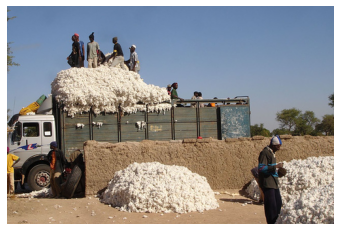

There is a jeep stuck in mud up to the doors.
Behind a pile of wood on a beach a group of men stand in a wooden boat.
A group of people are standing on a pile of wool in a truck.
The truck appears to be stuck in the mud.
Some men are sitting on a boat near a beach covered in stacked logs and sticks.


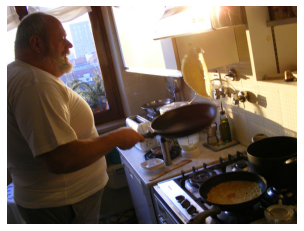

A waitress in a white t-shirt serving guests at a restaurant.
Two women in white t-shirts, one holding a knife slicing a pastry.
Two men in coat stand at a table with beakers and alcohol bottles.
A man is standing at a counter making a meal, following a recipe from a cookbook in front of him.
A man is mixing something in a large, round pan while several people are around him.


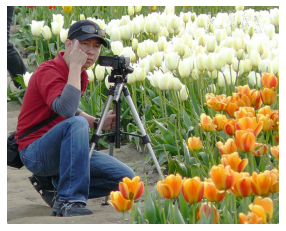

A man photographing tulips.
A person in a straw hat is sitting in weeds.
A man with a large hat in the bushes.
The woman in the blue hat is cutting food.
Pushing the flower pots to the garden to plant.


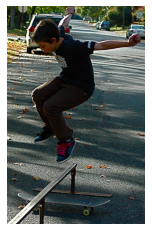

A young boy wearing a black shirt and brown pants practices jumping over a low bar on a skateboard.
A skateboarder wearing a green and purple hat does a kick flip out of an empty swimming pool.
Male on a skateboard, using an empty pool as a ramp on a very pretty day.
A guy with afro hair, gray sweater and jeans, skating on a skating ramp high up on the side touching grass.
A man with a Nike hat, Nike shirt, Nike shorts, and Nike shoes is sitting on some sort of public transportation.


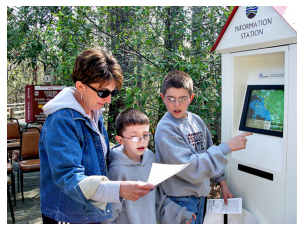

A man with a white shirt and a woman with a white shirt are talking on their phones.
A man wearing a black jacket and white shirt is talking to a woman at a bar.
A woman and a older man face each other over a counter.
A man wearing glasses and black clothing is sitting while a man in a vest drinks in the background.
A elderly lady and a middle-aged man talk over a table.


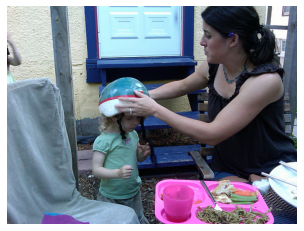

An Asian woman sits and serves a meal that she has just prepared.
Blond woman in a black floral t-shirt looking down while eating a hamburger.
A woman with a yellow scarf looks like she is in a market.
A girl opening her bottled drink while having lunch with a friend.
An Asian young woman is working with flower while surrounding by her peers.


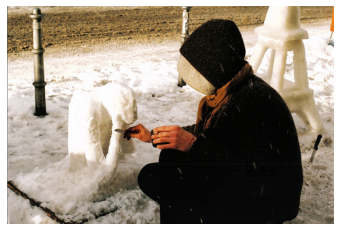

A man in winter clothing is laying in a pile of snow just outside a doorway.
A man sitting down making snow sculptures.
A person in a black winter coat and a scarf is carving a snow sculpture with a knife.
A man in a dark blue coat is lying in the snow outside of a home.
Monk in an orange robe raking leaves and debris on the ground.


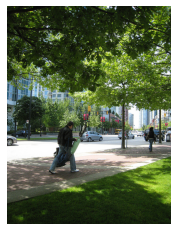

A large white building with many palm trees in front and a man with his hands in his pockets walking by.
Two trees in town in front of building
People outside walking and enjoying a sunny day.
Two men smoking outside of a park.
A man walks a few feet in front of a family.


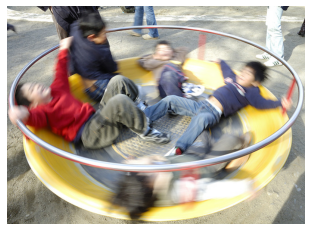

A child standing by a stroller and holding a toy sword.
A yelling child plays on blue monkey bars.
Girl in red jumping for joy.
A baby in a bouncy seat and a standing boy surrounded by toys.
Three children play outside with bubbles.


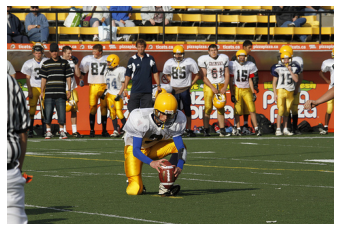

This football team wears red shirts and red helmets.
A boy wearing a yellow jersey is accepting the baton from a female wearing a yellow jersey in a relay race.
The American footballer wearing red is pushing the player in white to the ground.
A race car kicks up dust as it speeds down a gravel racetrack.
The men fight during the game.


In [50]:
from PIL import Image
dataset_path = data_path / 'imgs'
query_images = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900]
img_out = "./results/task_d/retrieval"
for index in query_images:
    img_info = val_data[index]
    filename = img_info['filename']
    img= Image.open(dataset_path / filename)
    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    plt.show()
    for i in range(5):
        j = neighbors[index][i]
        img_id = j//5
        text_id = j%5
        text = val_data[img_id]['sentences'][text_id]['raw']
        print(text)

In [27]:
indices = get_split_indices(val_data)

text_path = f'{data_path}/fasttext_feats.npy'
image_path = f'{data_path}/vgg_feats.mat'

img_features = loadmat(str(image_path))['feats'].T[indices]
text_features = np.load(str(text_path), allow_pickle=True)
text_features = mean_reduction(text_features)[indices]
text_features = text_features.reshape((-1, 300))

In [28]:
img_features = np.vstack(img_features)
txt_features = np.vstack(text_features)

img_labels = np.arange(len(img_features))
txt_labels = np.arange(len(img_features)).repeat(
    len(text_features) // len(img_features)
)

In [38]:
def UMAP_visualize(features_txt, features_img, text):
    reducer_txt = umap.UMAP()
    reducer_img = umap.UMAP()

    features_txt = reducer_txt.fit_transform(text_features)
    features_img = reducer_img.fit_transform(img_features)
    nelements = len(features_img)
    # Plot
    plt.figure(dpi=300, figsize=(6, 6))
    plt.title(f"UMAP of the text and image embeddings {text} metric learning")
    plt.scatter(
        features_txt[:5*nelements, 0],
        features_txt[:5*nelements, 1],
        color="orange",
        label="Text Embeddings"
    )
    plt.scatter(
        features_img[:nelements, 0],
        features_img[:nelements, 1],
        color="cyan",
        label="Image Embeddings"
    )
    plt.legend()
    plt.tight_layout()
    plt.show()
    plt.close()

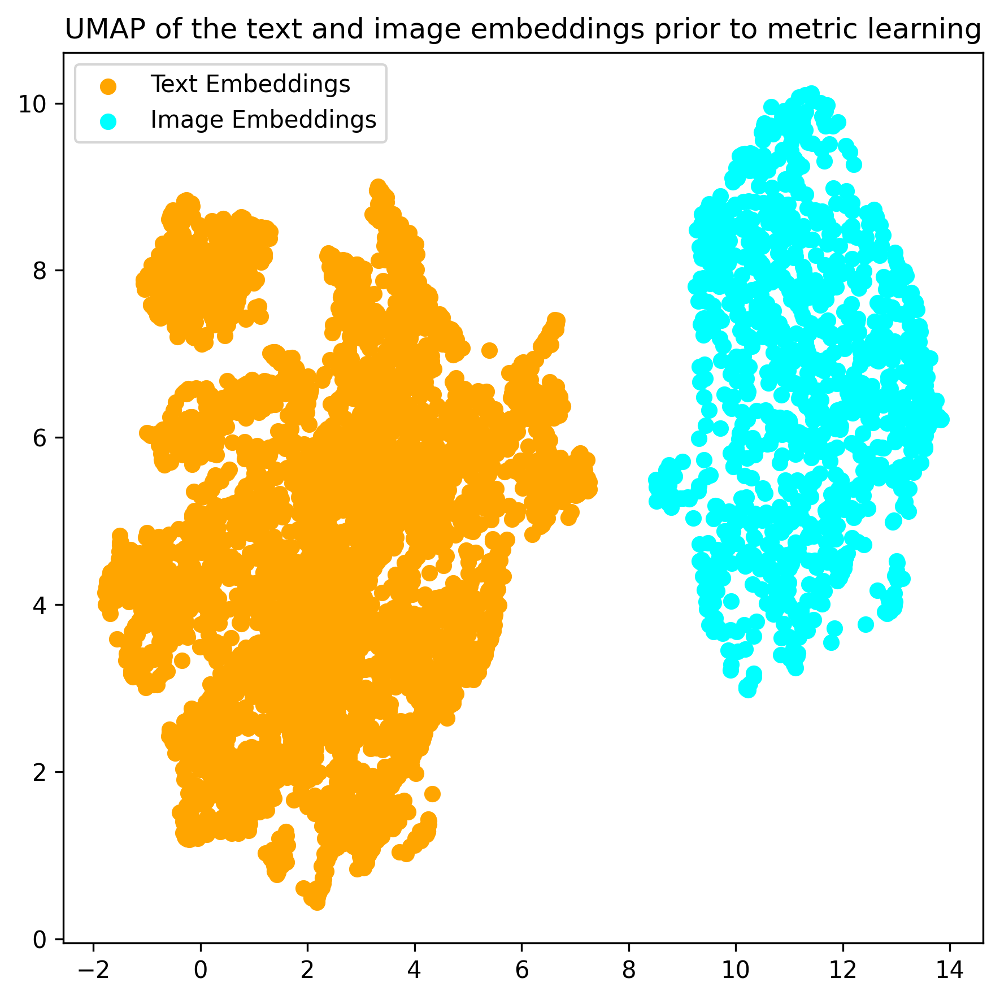

In [39]:
UMAP_visualize(text_features, img_features, 'prior to')

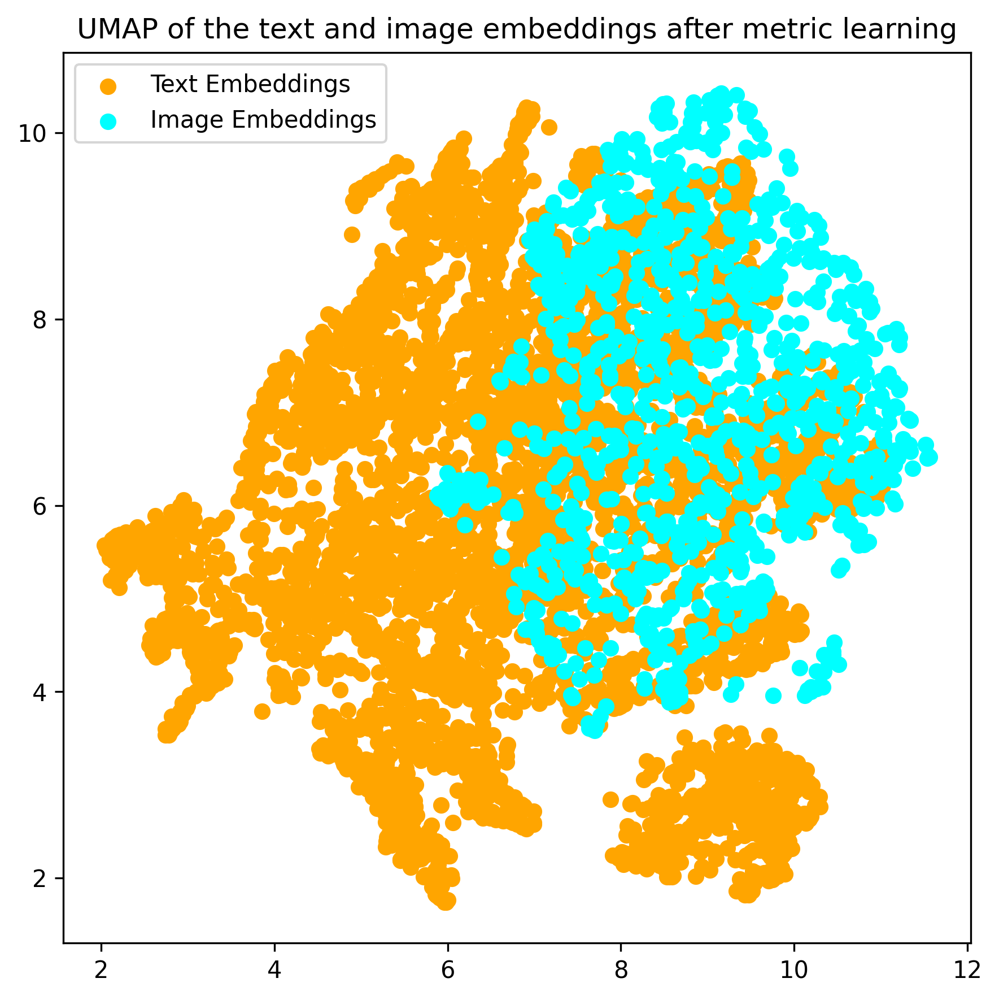

In [45]:
UMAP_visualize(all_txt_features, all_img_features, 'after')

TEST DATASET

In [51]:
all_img_features = test_features['img_features']
all_txt_features = test_features['txt_features']
all_img_labels = test_features['img_labels']
all_txt_labels = test_features['txt_labels']
anchor = "image"

In [52]:
knn = KNeighborsClassifier(5, metric="euclidean")

if anchor == "text":
    knn = knn.fit(all_img_features, all_img_labels)
    neighbors = knn.kneighbors(all_txt_features, return_distance=False)
    predictions = all_img_labels[neighbors]

    p1 = mpk(all_txt_labels, predictions, 1)
    p5 = mpk(all_txt_labels, predictions, 5)
    map = mAP(all_txt_labels,predictions)
else:
    knn = knn.fit(all_txt_features, all_txt_labels)
    neighbors = knn.kneighbors(all_img_features, return_distance=False)
    predictions = all_txt_labels[neighbors]

    p1 = mpk(all_img_labels, predictions, 1)
    p5 = mpk(all_img_labels, predictions, 5)
    map = mAP(all_img_labels,predictions)

print('P@1=',p1)
print('P@5=',p5)
print('mAP=',map)

P@1= 0.106
P@5= 0.0902
mAP= 0.16705277777777777


In [ ]:
img_labels = []
for i in all_img_labels.tolist():
    img_labels.append([i])

k_1=metrics.mapk(img_labels, predictions.tolist(), k=1)
k_5=metrics.mapk(img_labels, predictions.tolist(), k=5)

print('P@1=',k_1)
print('P@5=',k_5)

P@1= 0.106
P@5= 0.17271666666666668


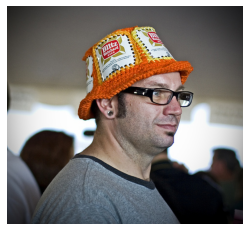

The man with pierced ears is wearing glasses and an orange hat.
A man wears an orange hat and glasses.
A man with a pensive look on his face shave off his beard.
A kid with his head shaved sitting and holding a lit cigarette.
A man with graying hair shaves his beard.


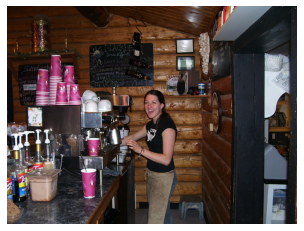

An asian woman demonstrating cooking with margarine in a public place
Latin woman shows off homemade pizza in kitchen.
Woman with white apron cooks food, large group of people sitting at tables behind her.
A lady attired in an apron stands over a kettle, preparing food, while patrons sit, chat, and dine in the background.
Several adults are filling their cups and a drink machine.


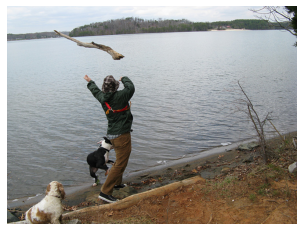

A dog is jumping over a stream of water on a sandy beach.
A dog jumping over a puddle on the beach
A dog jumping over a stream of water.
A smiling young girl swimming in a lake or river that has murky water.
A brown dog is shown standing in the water near a muddy beach.


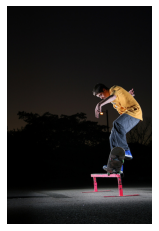

Gymnast doing handstand on a pole
A boy grimaces as he jumps high in the air.
A girl jumps in the air.
A female gymnast performing a jump.
A female gymnast, captured in midair during a jump.


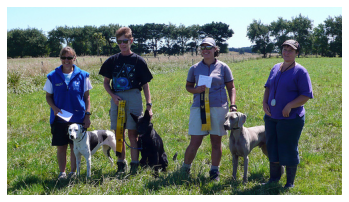

Four people stand with their dogs in a field.
Four people holding three dogs in a field.
The woman and three dogs are in a field.
Three dogs race towards the viewer over a lawn.
A group of dogs wearing muzzles running a race.


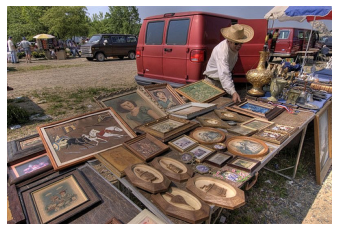

An Asian man sits on the tracks with crates of peanuts.
At an outdoor market, a small group of people stoop to buy potatoes from a street vendor, who has his goods laid out on the ground.
A homeless man holding a sign surrounded by buckets and crates.
An African American man surrounded by empty overturned white buckets and dark colored crates expresses himself through a message handwritten on cardboard.
An Asian man in a purple bandanna and dress shirt stands outside a restaurant nearby crates.


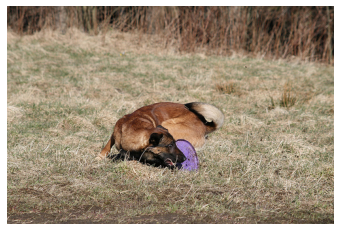

A large yellow dog is retrieving a stick.
A brown dog with white paws is trotting through a field of green grass.
A panting brown dog walking on the grass.
A brown dog is running through the grass panting.
A brown dog is walking on the grass.


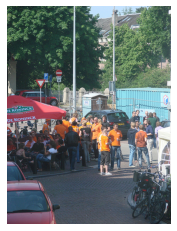

Four police officers are swallowed up by the large crowd of people on the street.
Military Families are marching through New York on a rainy day.
A crowd on a busy daytime street.
Police motorcycle waiting at a red light.
A crowd of guards standing on a sidewalk.


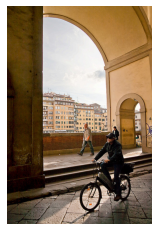

A person on a bicycle rides down the city sidewalk at night.
Many people outside on bicycles.
A girl straddles a bike rack on a city street.
A man on a bike in the city area.
A person rides up a narrow street on a bike, past a spray-painted sign of a hand giving the peace sign.


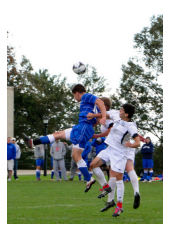

Male cheerleading squad performs at a park.
Spectators laugh as three people ride exercise balls down a field.
Kids compete to gain possession of the soccer ball.
Two people with their hands expressively out towards a sporting event's field.
Three kids are bouncing on large rubber balls in a grass field as other people watch.


In [ ]:
from PIL import Image
dataset_path = data_path / 'imgs'
query_images = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900]
img_out = "./results/task_d/retrieval"
for index in query_images:
    img_info = test_data[index]
    filename = img_info['filename']
    img= Image.open(dataset_path / filename)
    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    plt.show()
    for i in range(5):
        j = neighbors[index][i]
        img_id = j//5
        text_id = j%5
        text = test_data[img_id]['sentences'][text_id]['raw']
        print(text)
        
    

### TASK B

In [89]:
with (feature_path / "task_b/all_features_train.pkl").open('rb') as tr, \
        (feature_path / "task_b/all_features_validation.pkl").open('rb') as vl, \
        (feature_path / "task_b/all_features_test.pkl").open('rb') as ts:
    train_features = pickle.load(tr)
    val_features = pickle.load(vl)
    test_features = pickle.load(ts)

In [25]:
train_features.keys()

dict_keys(['txt_features', 'img_features', 'txt_labels', 'img_labels'])

TRAIN DATASET

In [90]:
all_img_features = train_features['img_features']
all_txt_features = train_features['txt_features']
all_img_labels = train_features['img_labels']
all_txt_labels = train_features['txt_labels']
anchor = "text"

In [87]:
knn = KNeighborsClassifier(5, metric="euclidean")

if anchor == "text":
    knn = knn.fit(all_img_features, all_img_labels)
    neighbors = knn.kneighbors(all_txt_features, return_distance=False)
    predictions = all_img_labels[neighbors]

    p1 = mpk(all_txt_labels, predictions, 1)
    p5 = mpk(all_txt_labels, predictions, 5)
    map = mAP(all_txt_labels,predictions)
else:
    knn = knn.fit(all_txt_features, all_txt_labels)
    neighbors = knn.kneighbors(all_img_features, return_distance=False)
    predictions = all_txt_labels[neighbors]

    p1 = mpk(all_img_labels, predictions, 1)
    p5 = mpk(all_img_labels, predictions, 5)
    map = mAP(all_img_labels,predictions)

print('P@1=',p1)
print('P@5=',p5)
print('mAP=',map)

P@1= 0.008986206896551724
P@5= 0.007260689655172414
mAP= 0.017914022988505748


Two young guys with shaggy hair look at their hands while hanging out in the yard.


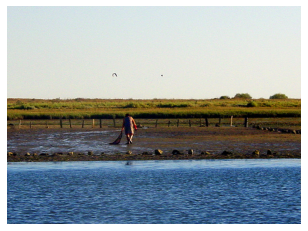

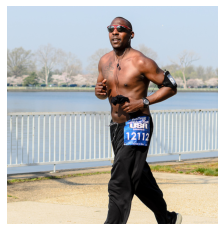

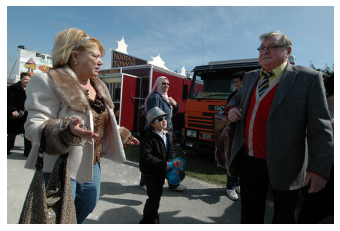

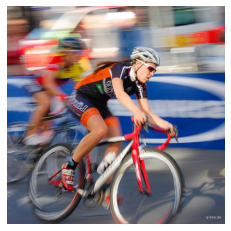

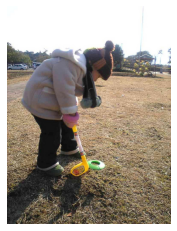

A toddler in a blue shirt with red shorts and hat looks out from behind a fenced in area of a brick patio.


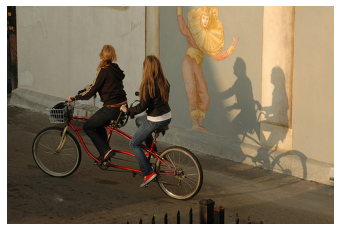

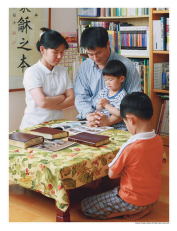

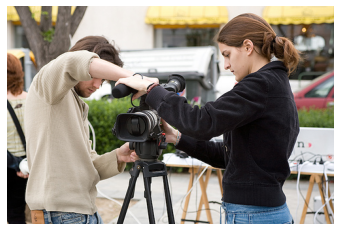

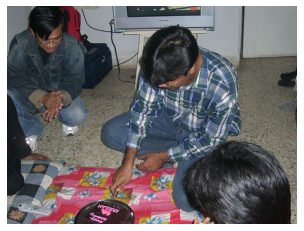

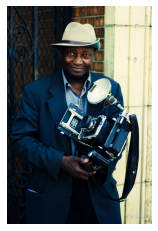

A woman is resting against a cross shaped pole while looking towards a large body of water.


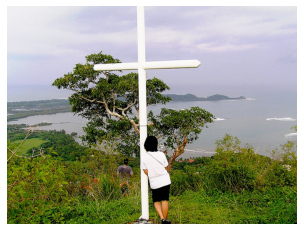

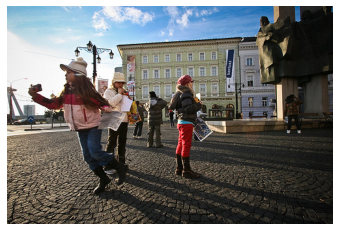

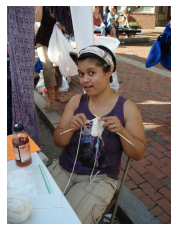

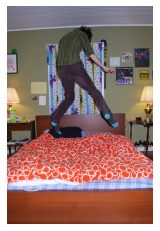

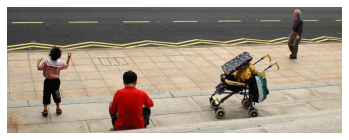

A kid wearing a Gap hat looks into the camera with a funny face and ice cream cone in his hand while a woman looks on from behind him.


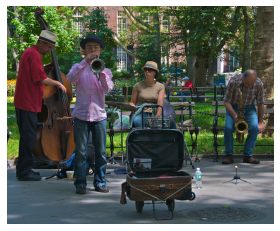

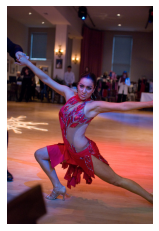

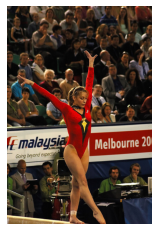

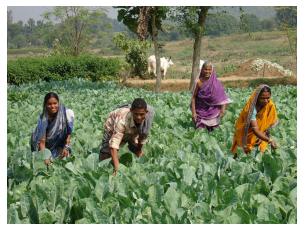

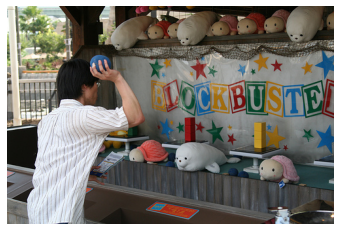

A child and a man sit on the ground together, ready to use paintbrushes and a bucket.


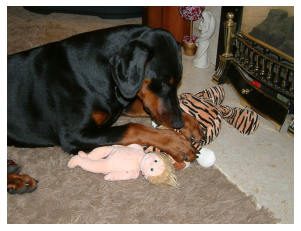

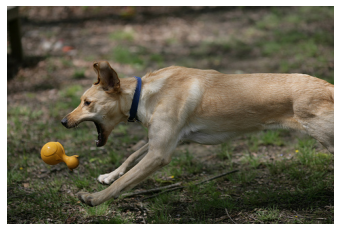

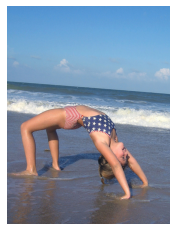

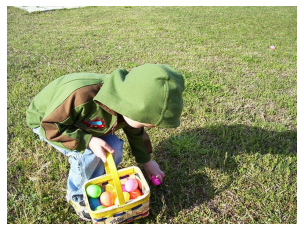

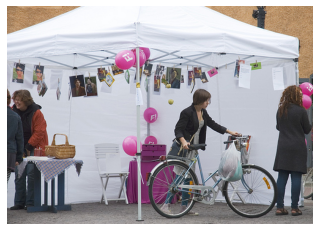

Eleven men and women in cotton shirts and denim pants walk uphill along a shaded forest trail.


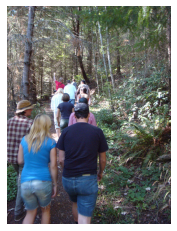

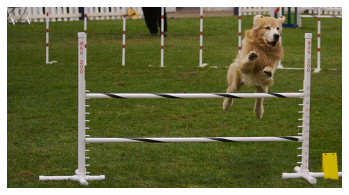

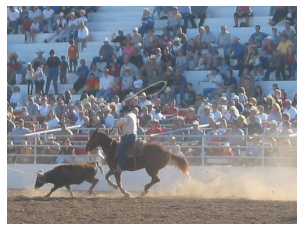

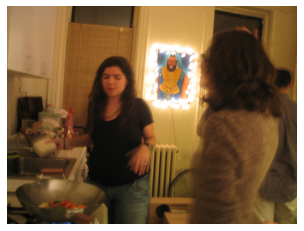

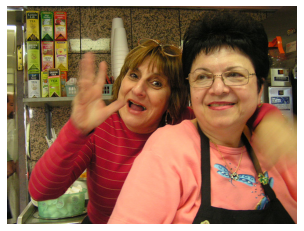

A man wearing glasses holds a flip phone in his hand while a woman wearing earrings stands behind him.


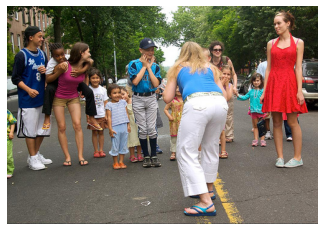

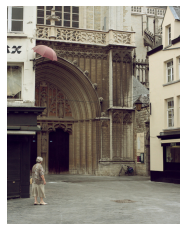

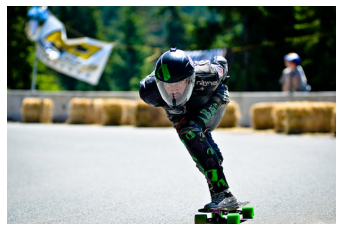

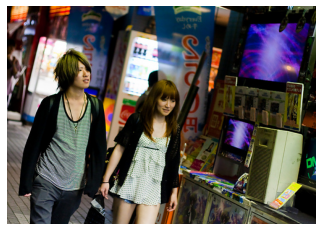

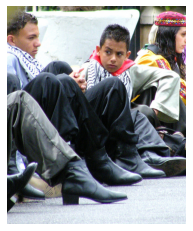

Man dressed in coat, scarf, and hat painting a picture of a building on an easel in the streets.


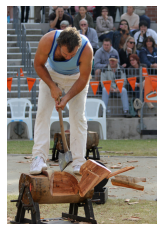

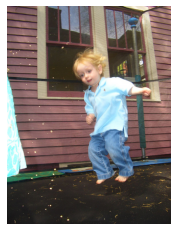

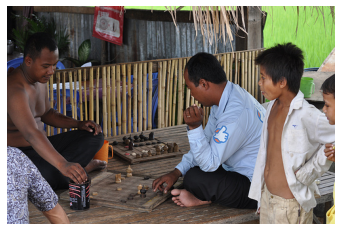

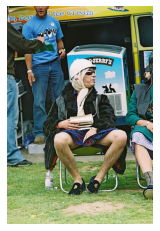

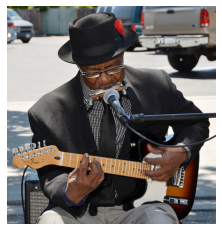

A female swimmer in a black bathing suit about to jump off the racing platform into a pool.


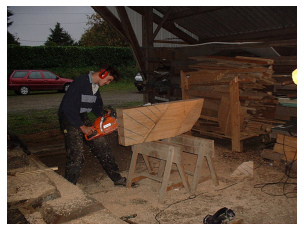

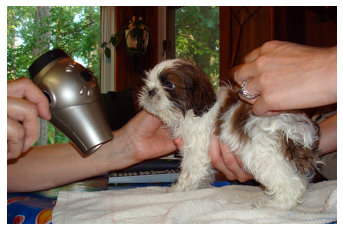

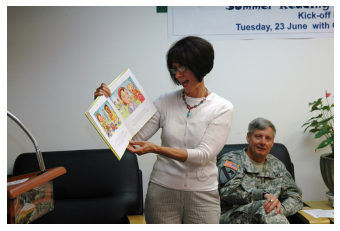

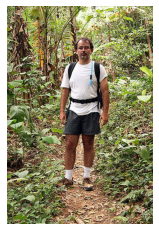

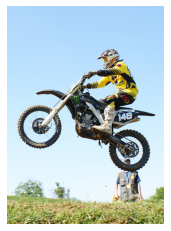

A man in jeans and sandals sits outside near trees and a goose and plays a string instrument.


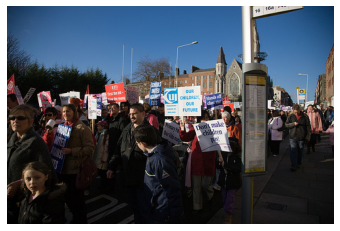

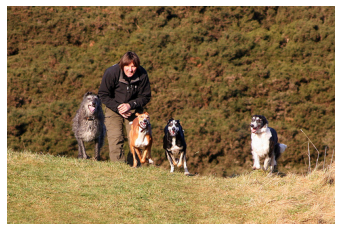

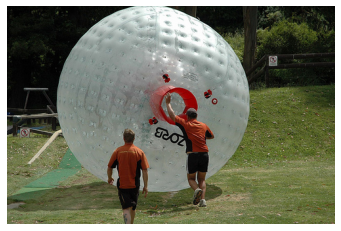

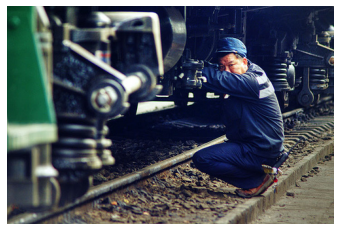

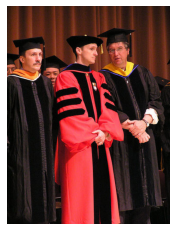

In [88]:
from PIL import Image
dataset_path = data_path / 'imgs'
query_texts = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900]
img_out = "./results/task_d/retrieval"
for index in query_texts:
    text = train_data[index]['sentences'][0]['raw']
    print(text)
    figures = {}
    for i in range(5):
        j = neighbors[index*5][i]
        filename = train_data[j]['filename']
        figures['Image '+str(i)] = Image.open(dataset_path / filename)
        fig, ax = plt.subplots()
        ax.imshow(figures['Image '+str(i)])
        ax.spines['top'].set_visible(False)
        ax.spines['left'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.set_xticks([])
        ax.set_yticks([])
        plt.show()
    #plot_figures(figures, 1, len(figures))

VALIDATION DATASET

In [91]:
all_img_features = val_features['img_features']
all_txt_features = val_features['txt_features']
all_img_labels = val_features['img_labels']
all_txt_labels = val_features['txt_labels']
anchor = "text"

In [92]:
knn = KNeighborsClassifier(5, metric="euclidean")

if anchor == "text":
    knn = knn.fit(all_img_features, all_img_labels)
    neighbors = knn.kneighbors(all_txt_features, return_distance=False)
    predictions = all_img_labels[neighbors]

    p1 = mpk(all_txt_labels, predictions, 1)
    p5 = mpk(all_txt_labels, predictions, 5)
    map = mAP(all_txt_labels,predictions)
else:
    knn = knn.fit(all_txt_features, all_txt_labels)
    neighbors = knn.kneighbors(all_img_features, return_distance=False)
    predictions = all_txt_labels[neighbors]
    
    p1 = mpk(all_img_labels, predictions, 1)
    p5 = mpk(all_img_labels, predictions, 5)
    map = mAP(all_img_labels,predictions)

print('P@1=',p1)
print('P@5=',p5)
print('mAP=',map)

P@1= 0.09270216962524655
P@5= 0.05680473372781065
mAP= 0.15790269559500328


In [93]:
txt_labels = []
for i in all_txt_labels.tolist():
    txt_labels.append([i])

k_1=metrics.mapk(txt_labels, predictions.tolist(), k=1)
k_5=metrics.mapk(txt_labels, predictions.tolist(), k=5)

print('P@1=',k_1)
print('P@5=',k_5)

P@1= 0.09270216962524655
P@5= 0.15790269559500328


A group of people stand in the back of a truck filled with cotton.


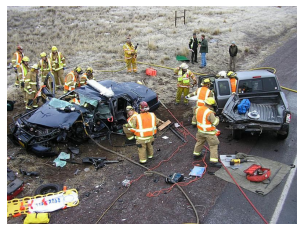

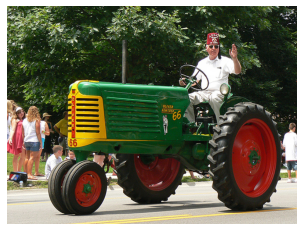

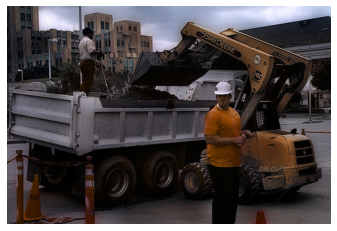

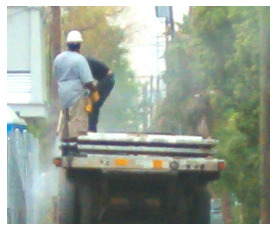

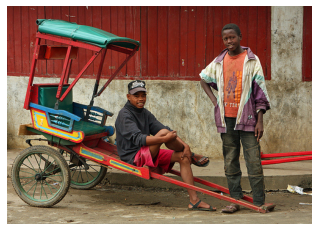

A large bearded man flips a crepe or omelet in midair with his frying pan.


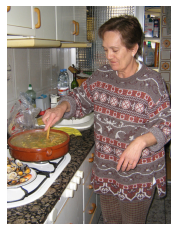

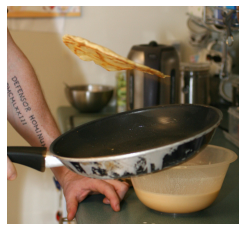

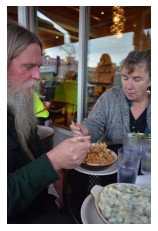

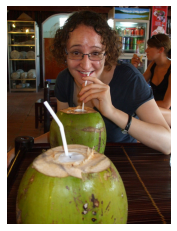

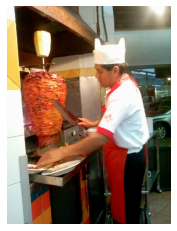

A man is taking photographs of a large garden of white and orange tulips.


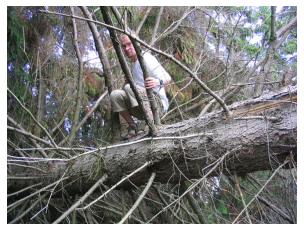

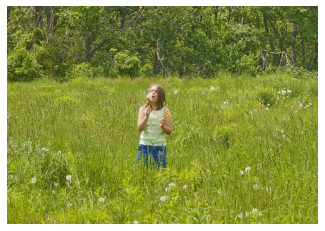

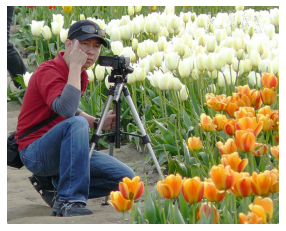

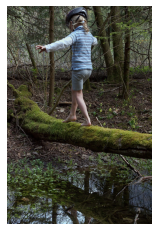

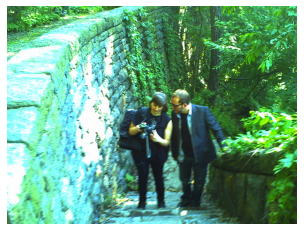

A young boy wearing a black shirt and brown pants practices jumping over a low bar on a skateboard.


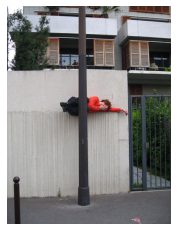

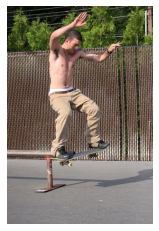

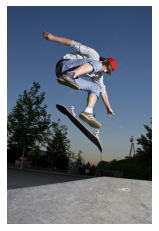

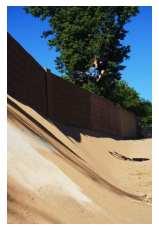

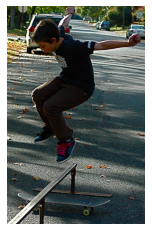

A woman in a jean jacket and black sunglasses stands outside with two young boys by a kiosk, looking at a paper she is holding in her hand.


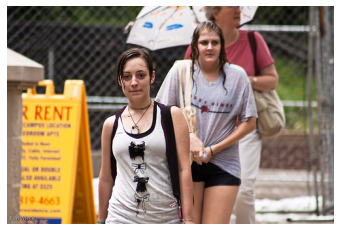

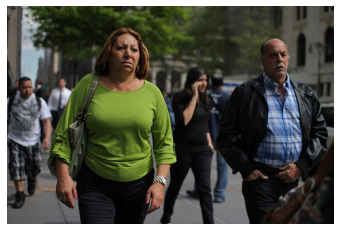

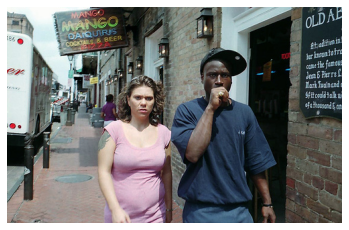

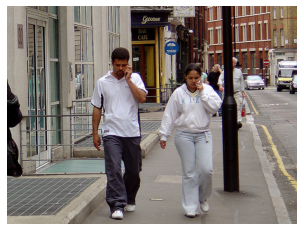

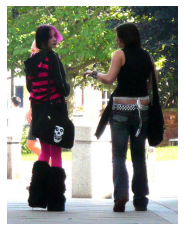

A little girl in front a pink food tray is getting her bike helmet on by a woman.


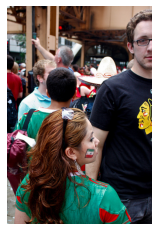

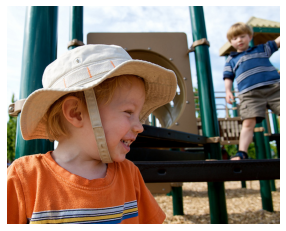

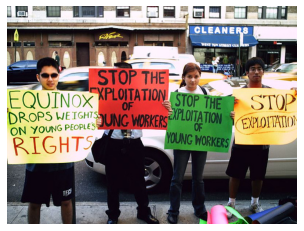

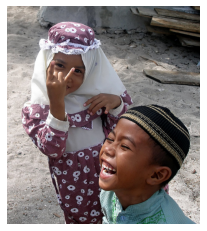

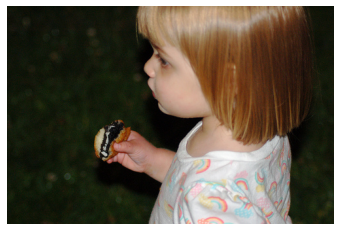

A hooded individual with an orange scarf and face covering uses a small knife to sculpt a piece of ice.


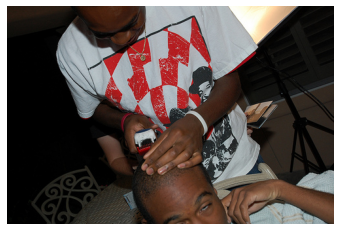

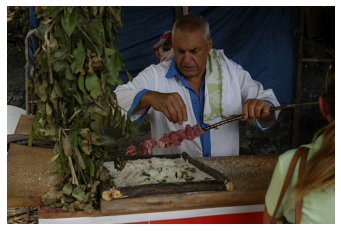

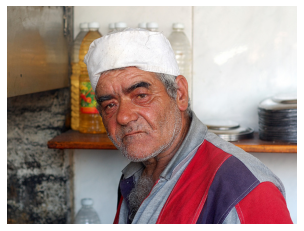

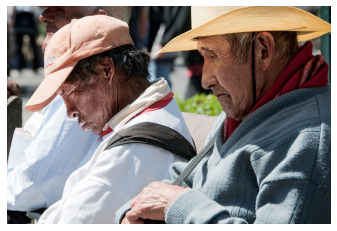

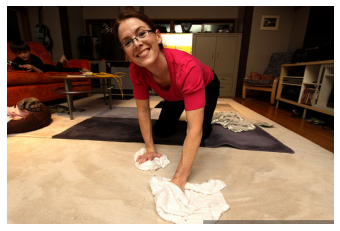

Guy in jeans and black jacket walking along grass and trees with the city in the background.


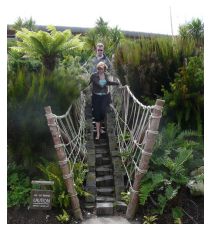

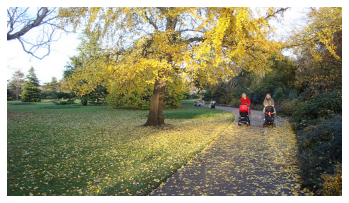

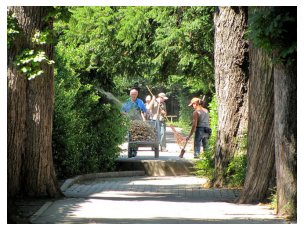

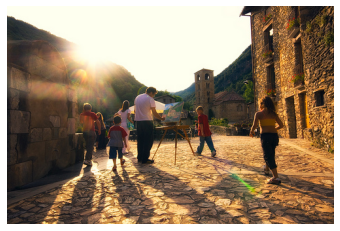

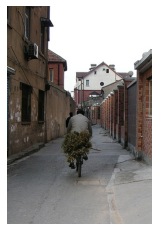

Five children spin around on a playground roundabout; three lay on their backs, while one attempts to pull himself up with both arms, and another holds onto the side while sitting up.


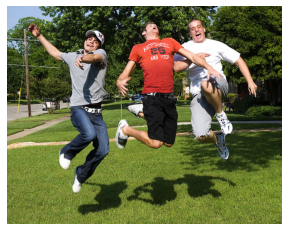

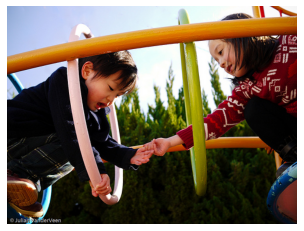

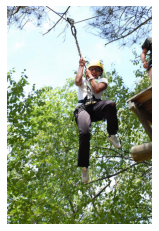

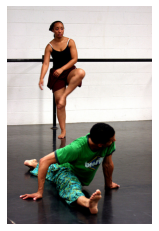

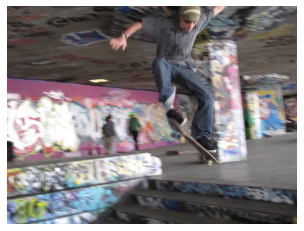

A football player preparing a football for a field goal kick, while his teammates can coach watch him.


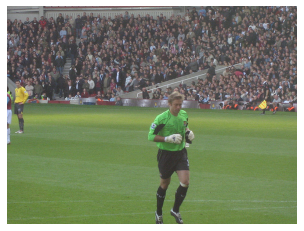

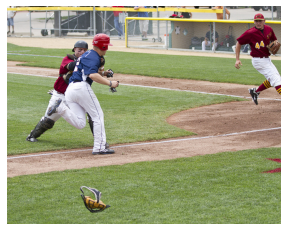

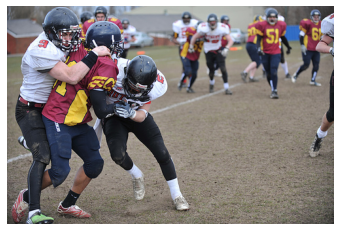

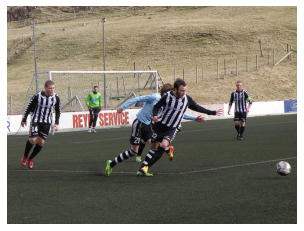

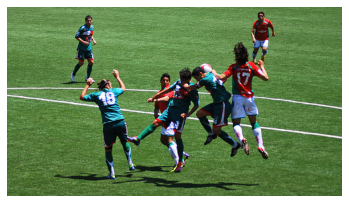

In [84]:
from PIL import Image
dataset_path = data_path / 'imgs'
query_texts = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900]
img_out = "./results/task_d/retrieval"
for index in query_texts:
    text = val_data[index]['sentences'][0]['raw']
    print(text)
    figures = {}
    for i in range(5):
        j = neighbors[index*5][i]
        filename = val_data[j]['filename']
        figures['Image '+str(i)] = Image.open(dataset_path / filename)
        fig, ax = plt.subplots()
        ax.imshow(figures['Image '+str(i)])
        ax.spines['top'].set_visible(False)
        ax.spines['left'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.set_xticks([])
        ax.set_yticks([])
        plt.show()
    #plot_figures(figures, 1, len(figures))

TEST DATASET

In [94]:
all_img_features = test_features['img_features']
all_txt_features = test_features['txt_features']
all_img_labels = test_features['img_labels']
all_txt_labels = test_features['txt_labels']
anchor = "text"

In [95]:
knn = KNeighborsClassifier(5, metric="euclidean")

if anchor == "text":
    knn = knn.fit(all_img_features, all_img_labels)
    neighbors = knn.kneighbors(all_txt_features, return_distance=False)
    predictions = all_img_labels[neighbors]

    p1 = mpk(all_txt_labels, predictions, 1)
    p5 = mpk(all_txt_labels, predictions, 5)
    map = mAP(all_txt_labels,predictions)
else:
    knn = knn.fit(all_txt_features, all_txt_labels)
    neighbors = knn.kneighbors(all_img_features, return_distance=False)
    predictions = all_txt_labels[neighbors]

    p1 = mpk(all_img_labels, predictions, 1)
    p5 = mpk(all_img_labels, predictions, 5)
    map = mAP(all_img_labels,predictions)

print('P@1=',p1)
print('P@5=',p5)
print('mAP=',map)

P@1= 0.0844
P@5= 0.0558
mAP= 0.15173333333333333


In [96]:
txt_labels = []
for i in all_txt_labels.tolist():
    txt_labels.append([i])

k_1=metrics.mapk(txt_labels, predictions.tolist(), k=1)
k_5=metrics.mapk(txt_labels, predictions.tolist(), k=5)

print('P@1=',k_1)
print('P@5=',k_5)

P@1= 0.0844
P@5= 0.15173333333333333


In [76]:
len(neighbors)

5000

The man with pierced ears is wearing glasses and an orange hat.


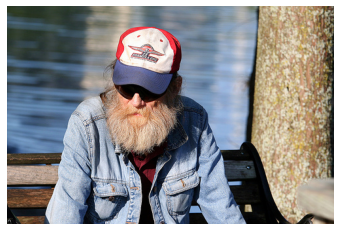

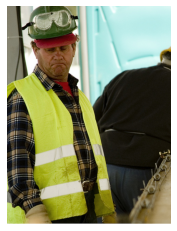

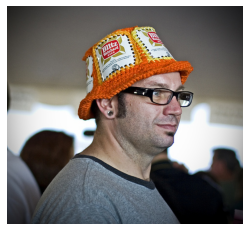

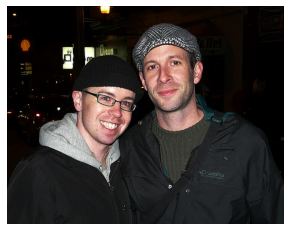

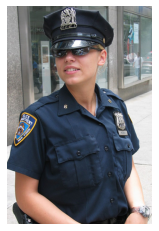

A woman with a black shirt and tan apron is standing behind a counter in a restaurant.


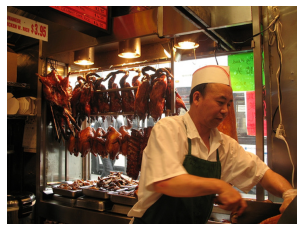

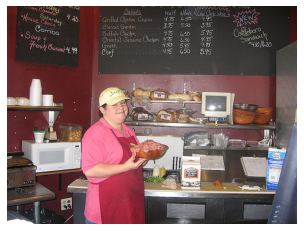

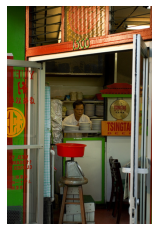

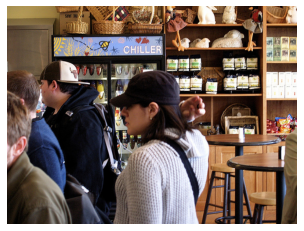

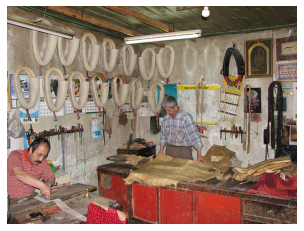

A person in a green jacket throws a stick into the water for a black and white dog to fetch whilst a brown and white dog looks on.


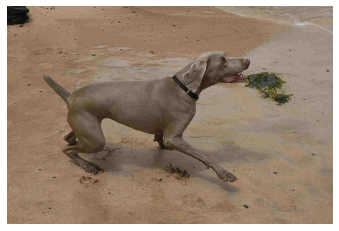

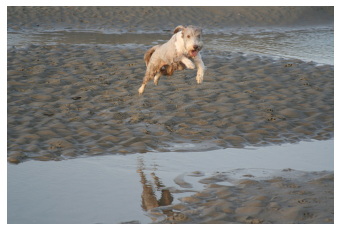

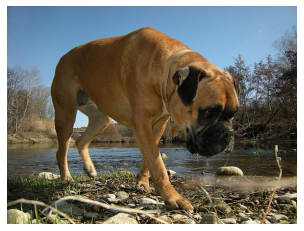

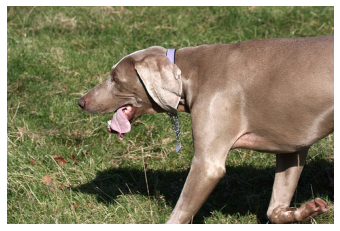

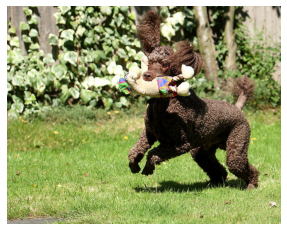

The boy in the yellow shirt is riding a skateboard along a red bar.


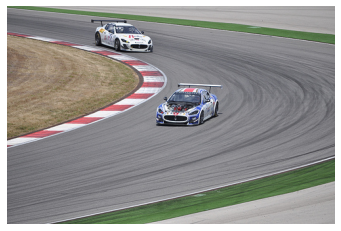

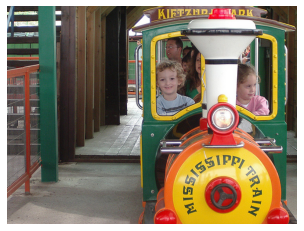

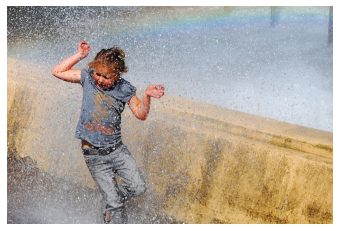

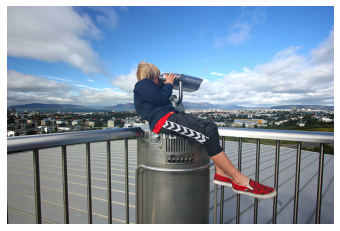

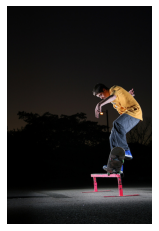

Four dog owners stand with their three prize winning dogs.


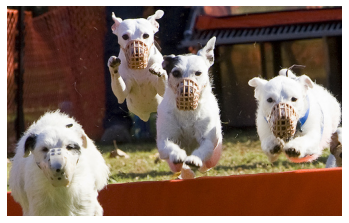

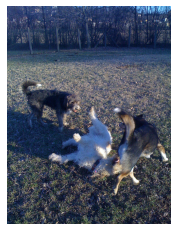

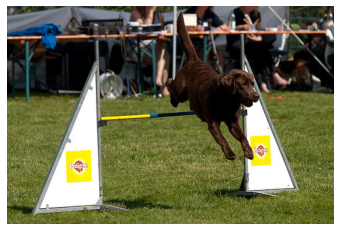

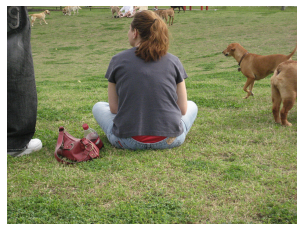

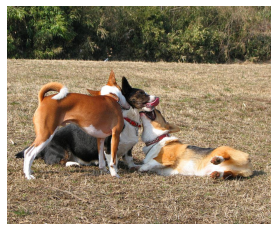

Standing outside in front of a red van, a man in a hat picks up a framed painting from a table full of such paintings and other art.


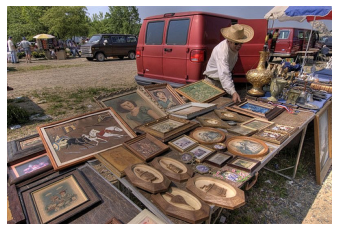

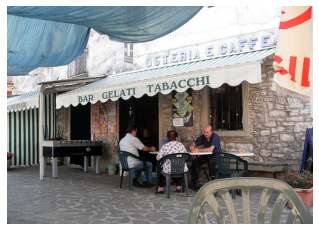

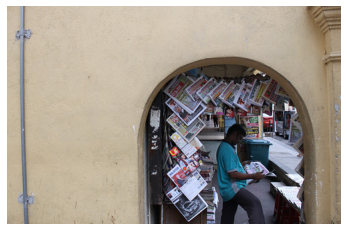

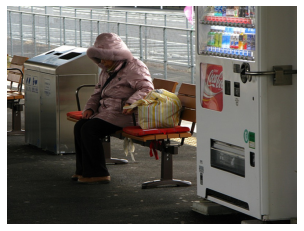

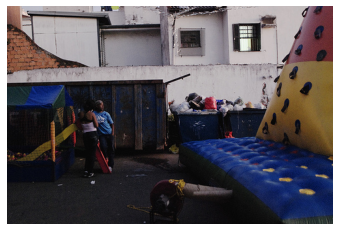

The dog is concerned with a purple object lying in an uncut field.


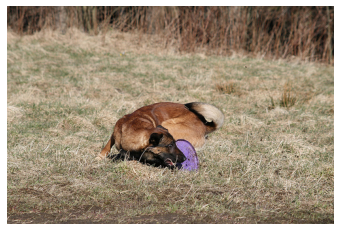

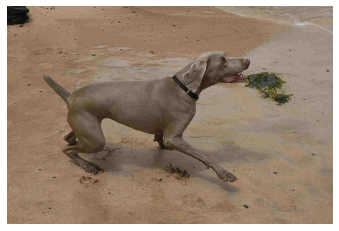

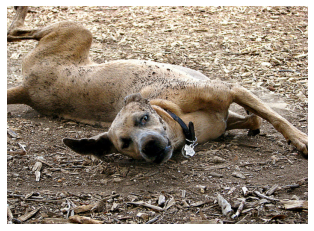

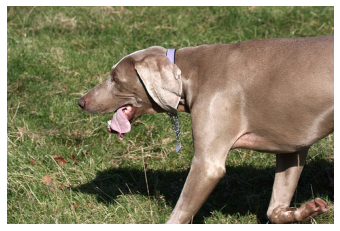

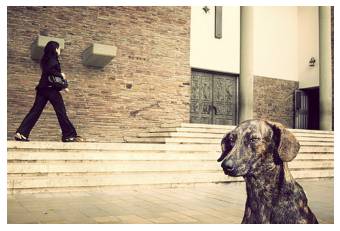

People are gathered under a big red "De Koninck" umbrella while men in orange talk to the side.


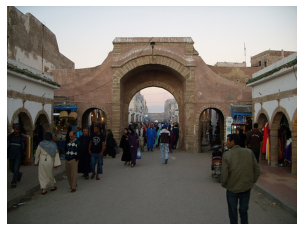

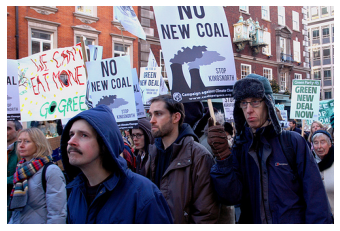

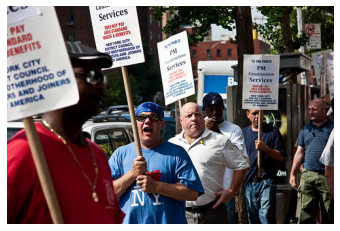

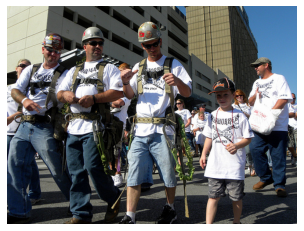

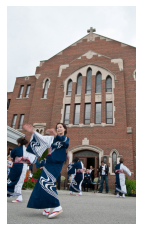

A man in a black hat and jacket is riding his bicycle.


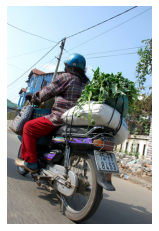

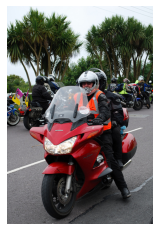

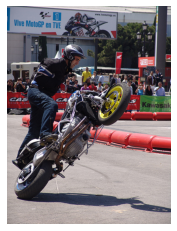

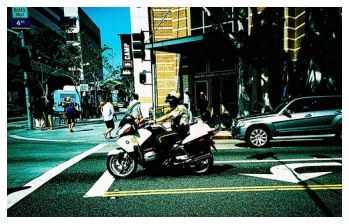

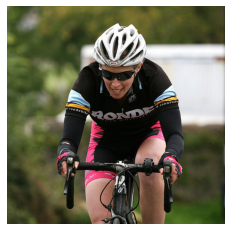

Soccer players dressed in bright blue and white uniforms are jumping in the air.


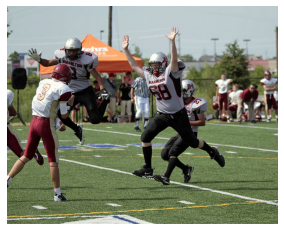

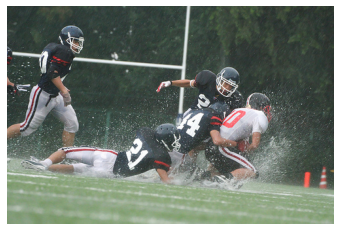

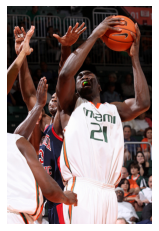

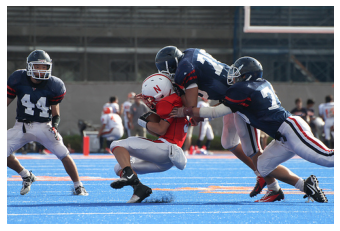

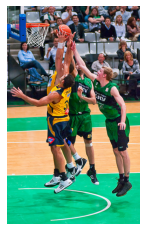

In [78]:
from PIL import Image
dataset_path = data_path / 'imgs'
query_texts = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900]
img_out = "./results/task_d/retrieval"
for index in query_texts:
    text = test_data[index]['sentences'][0]['raw']
    print(text)
    figures = {}
    for i in range(5):
        j = neighbors[index*5][i]
        filename = test_data[j]['filename']
        figures['Image '+str(i)] = Image.open(dataset_path / filename)
        fig, ax = plt.subplots()
        ax.imshow(figures['Image '+str(i)])
        ax.spines['top'].set_visible(False)
        ax.spines['left'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.set_xticks([])
        ax.set_yticks([])
        plt.show()
    #plot_figures(figures, 1, len(figures))
    

### TASK D

In [79]:
with (feature_path / "task_d/all_features_train.pkl").open('rb') as tr, \
        (feature_path / "task_d/all_features_validation.pkl").open('rb') as vl, \
        (feature_path / "task_d/all_features_test.pkl").open('rb') as ts:
    train_features = pickle.load(tr)
    val_features = pickle.load(vl)
    test_features = pickle.load(ts)

In [12]:
train_features.keys()

dict_keys(['txt_features', 'img_features', 'txt_labels', 'img_labels'])

TRAIN DATASET

In [63]:
all_img_features = train_features['img_features']
all_txt_features = train_features['txt_features']
all_img_labels = train_features['img_labels']
all_txt_labels = train_features['txt_labels']
anchor = "image"

In [64]:
knn = KNeighborsClassifier(5, metric="euclidean")

if anchor == "text":
    knn = knn.fit(all_img_features, all_img_labels)
    neighbors = knn.kneighbors(all_txt_features, return_distance=False)
    predictions = all_img_labels[neighbors]

    p1 = mpk(all_txt_labels, predictions, 1)
    p5 = mpk(all_txt_labels, predictions, 5)
    map = mAP(all_txt_labels,predictions)
else:
    knn = knn.fit(all_txt_features, all_txt_labels)
    neighbors = knn.kneighbors(all_img_features, return_distance=False)
    predictions = all_txt_labels[neighbors]

    p1 = mpk(all_img_labels, predictions, 1)
    p5 = mpk(all_img_labels, predictions, 5)
    map = mAP(all_img_labels,predictions)

print('P@1=',p1)
print('P@5=',p5)
print('mAP=',map)

P@1= 0.012862068965517242
P@5= 0.011820689655172417
mAP= 0.026084770114942524


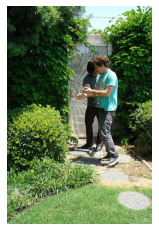

A group of people are running on the sand.
A cashier in asia with some money in her hand.
Two blond people are sitting in a park having a conversation.
A young man looks into the camera while a crowd of people on a busy street pass by.
A child and an adult are walking down the sidewalk.


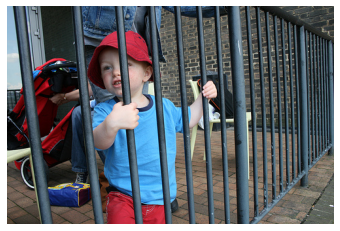

A little boy is leaping in the air onto a water slide.
A man wearing a beanie painting a realistic portrait of a building.
Woman holding a drink with a white bag next to her is sitting on a green sculpture.
Black dog jumps for white ball.
A boy swinging on a swing.


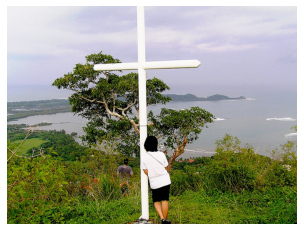

A boy, playing in the water, with the sun upon the horizon.
2 men in white coats are looking on in a Chinese restaurant.
A man stands at the peak of a mountain and has his hand on a monument.
Two mountain climbers sit on a mountain.
People in orange robes line up behind a man wearing sunglasses.


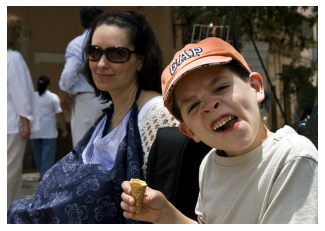

Two onlookers watch a young man as he gets ready to make a hit.
Two elderly women are looking into an ice cream cart.
An awards ceremony with cannons shooting confetti into the air.
A guy riding a bike on a track.
A woman is choosing a perfume


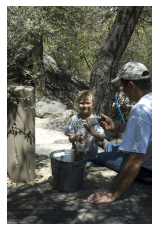

A man being bucked off a bronco at a rodeo.
Team member 39 waiting for the puck to come his way.
A man wearing a backwards blue cap hands something to one man in a line of men.
Two men in jogging attired are running through the woods.
One soccer player is moving the ball while an opposing player prepares to try to take the ball, with another player and an official in the background.


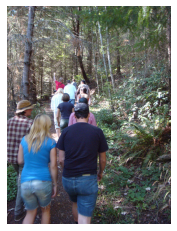

Man on a makeshift scaffolding, fixing a window.
A woman enjoying a sucker is looking out over a railing.
Many people in dark cloths are drinking and talking together.
A group of men, blind folded, walking down the street.
A man and a girl are sitting on a bench.


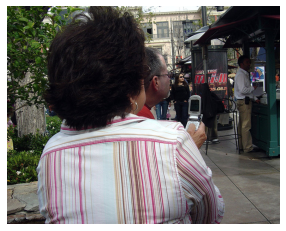

A crowd forms to watch as a man breakdances in the street.
A man in a yellow jumpsuit and blue face mask welds a metal beam.
A man swinging at a tennis ball with a green sign that read findersport.
A man and a young girl relax outside and smile at the camera.
One male is sitting in a marketplace looking aimlessly forward amidst the colorful solid and printed fabrics in the background with a pile of grain in front of him.


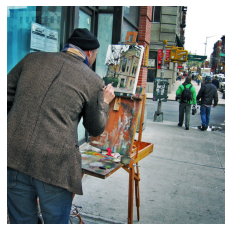

A man and a small boy watch their small, white dog catch a toy in the air.
A rally vehicle creates a dust cloud while racing.
A white dog runs past another dog who is standing beside some patio furniture.
A woman in a suit is standing at a podium while speaking.
Two people walking on the street with lots of bare trees around and snow on the ground.


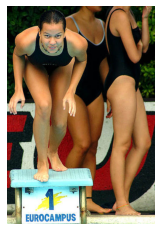

Many people with life jackets on are getting into boats on an icy river.
A guy is playing the bagpipes while standing next to a woman in a light blue outfit with her belly button showing.
A white female wearing a hooded maroon sweater carries an object across a shallow river.
A young Asian girl sits in an orange chair and looks away from the camera.
A man wearing a mask is squatting on the ground.


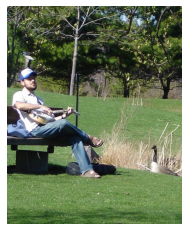

A group of patrons sitting in green lounge chairs along a waterway, one of them has a black jacket across her chair, and is looking out at the water.
Two Black women are walking under a covered structure.
A group of friends around a fire protected with a metallic mesh.
An oriental girl walking in front of water.
A dark complexioned man is shaving the hairs off his head


In [66]:
from PIL import Image
dataset_path = data_path / 'imgs'
query_images = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900]
img_out = "./results/task_d/retrieval"
for index in query_images:
    img_info = train_data[index]
    filename = img_info['filename']
    img= Image.open(dataset_path / filename)
    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    plt.show()
    for i in range(5):
        j = neighbors[index][i]
        img_id = j//5
        text_id = j%5
        text = train_data[img_id]['sentences'][text_id]['raw']
        print(text)

VALIDATION DATASET

In [8]:
all_img_features = val_features['img_features']
all_txt_features = val_features['txt_features']
all_img_labels = val_features['img_labels']
all_txt_labels = val_features['txt_labels']
anchor = "image"

In [9]:
knn = KNeighborsClassifier(5, metric="euclidean")

if anchor == "text":
    knn = knn.fit(all_img_features, all_img_labels)
    neighbors = knn.kneighbors(all_txt_features, return_distance=False)
    predictions = all_img_labels[neighbors]

    p1 = mpk(all_txt_labels, predictions, 1)
    p5 = mpk(all_txt_labels, predictions, 5)
    map = mAP(all_txt_labels,predictions)
else:
    knn = knn.fit(all_txt_features, all_txt_labels)
    neighbors = knn.kneighbors(all_img_features, return_distance=False)
    predictions = all_txt_labels[neighbors]
    
    p1 = mpk(all_img_labels, predictions, 1)
    p5 = mpk(all_img_labels, predictions, 5)
    map = mAP(all_img_labels,predictions)

print('P@1=',p1)
print('P@5=',p5)
print('mAP=',map)

P@1= 0.1222879684418146
P@5= 0.10019723865877711
mAP= 0.1819293776024545


In [20]:
img_labels = []
for i in all_img_labels.tolist():
    img_labels.append([i])

k_1=metrics.mapk(img_labels, predictions.tolist(), k=1)
k_5=metrics.mapk(img_labels, predictions.tolist(), k=5)

print('P@1=',k_1)
print('P@5=',k_5)

P@1= 0.1222879684418146
P@5= 0.19094345825115056


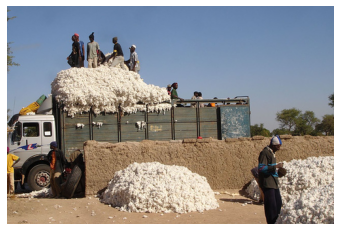

People with camping equipment on rocky ground.
Workers working in the mud and sand.
Three guys are jumping on some grass and making funny faces, you can see their shadows on the ground.
Three cold men set down their supplies in a ditch.
A constructions site on the side of the mountain with a bulldozer digging in the ground that is all dirt


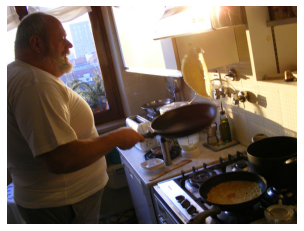

Three food industry workers share a laugh.
A man is mixing something in a large, round pan while several people are around him.
A man in a white shirt is making shish kabob.
A somewhat chubby man making hand gestures with a other man at the sink looking at him.
Two men in coat stand at a table with beakers and alcohol bottles.


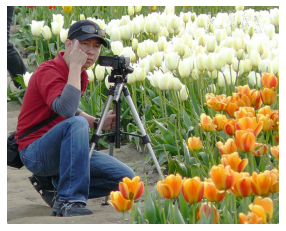

A man in an orange draped outfit raking leaves.
A gentleman selling banana's and grapes.
A person in a straw hat is sitting in weeds.
A man holding a shovel above his head is posing in front of a campfire.
A man kneels down near a large balloon in an open field.


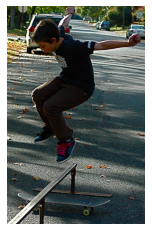

Man attempts skateboard trick in tree-lined skate park.
A boy is doing a stunt with his skateboard.
A male teenager doing a trick in a skate park on a skateboard.
A teen performing a bike trick at a skate park.
A boy jumping a rail on his skateboard.


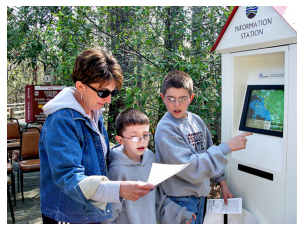

A woman in a sky-blue shirt faces an older man wearing a navy cap.
A man with a white shirt and a woman with a white shirt are talking on their phones.
A young man gives another young man advise on sex and dating.
A man wearing a black jacket and white shirt is talking to a woman at a bar.
Two African American men laughing with aprons on, while a third man wearing a chef jacket is on a cellular phone.


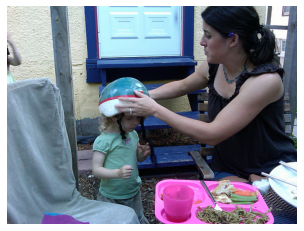

An Asian young woman is working with flower while surrounding by her peers.
Two girls play with their food for the camera.
Two young girls having fun while eating.
Several girls are playing with flour.
Two girls enjoying and sharing their ideas.


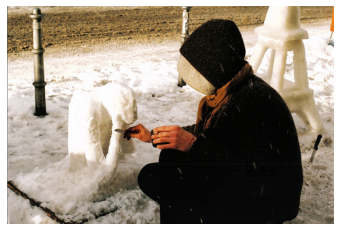

A boy dressed in a dark shirt carries a blue bag over his shoulder and a green pail.
A male in a black shirt and brown cargo pants holding a shovel above his head.
A man has a pan and what looks like a block of dirt.
An old man holding a small hatchet.
A woman is sanding a porch with an electric sander.


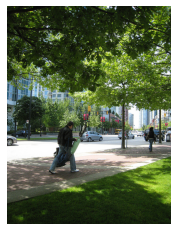

A young couple kissing on a park bench.
Couple is making out on a park bench in public.
A couple sits on a bench talking, while a woman walks a dog in the background.
Here is a picture of a woman and her husband and child taking a stroll by the parking lot.
A man and woman are having a conversation on a park bench.


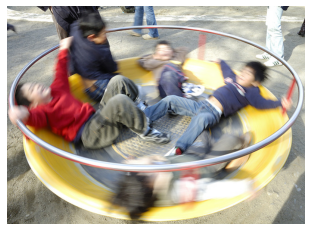

Two asian children grab hands while in a piece of playground equipment.
Two young Asian children are playing on playground equipment.
Little boy juggling orange balls in the park with a playground behind him.
Young children playing on a stoop with a bubble maker.
Three young children stand around a blue and white barrel.


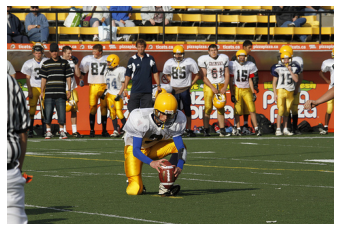

Ballplayers in blue and white uniforms are on the field playing baseball.
A child slid home as all the other baseball players looked on.
A soccer team wearing light blue gets in a huddle during a match.
Three men are running in a track and field race involving hurdles.
The marathon runners draw the race to a close as their supporters Cheer!


In [61]:
from PIL import Image
dataset_path = data_path / 'imgs'
query_images = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900]
img_out = "./results/task_d/retrieval"
for index in query_images:
    img_info = val_data[index]
    filename = img_info['filename']
    img= Image.open(dataset_path / filename)
    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    plt.show()
    for i in range(5):
        j = neighbors[index][i]
        img_id = j//5
        text_id = j%5
        text = val_data[img_id]['sentences'][text_id]['raw']
        print(text)

TEST DATASET

In [21]:
all_img_features = test_features['img_features']
all_txt_features = test_features['txt_features']
all_img_labels = test_features['img_labels']
all_txt_labels = test_features['txt_labels']
anchor = "image"

In [22]:
knn = KNeighborsClassifier(5, metric="euclidean")

if anchor == "text":
    knn = knn.fit(all_img_features, all_img_labels)
    neighbors = knn.kneighbors(all_txt_features, return_distance=False)
    predictions = all_img_labels[neighbors]

    p1 = mpk(all_txt_labels, predictions, 1)
    p5 = mpk(all_txt_labels, predictions, 5)
    map = mAP(all_txt_labels,predictions)
else:
    knn = knn.fit(all_txt_features, all_txt_labels)
    neighbors = knn.kneighbors(all_img_features, return_distance=False)
    predictions = all_txt_labels[neighbors]

    p1 = mpk(all_img_labels, predictions, 1)
    p5 = mpk(all_img_labels, predictions, 5)
    map = mAP(all_img_labels,predictions)

print('P@1=',p1)
print('P@5=',p5)
print('mAP=',map)

P@1= 0.109
P@5= 0.0984
mAP= 0.17606111111111114


In [23]:
img_labels = []
for i in all_img_labels.tolist():
    img_labels.append([i])

k_1=metrics.mapk(img_labels, predictions.tolist(), k=1)
k_5=metrics.mapk(img_labels, predictions.tolist(), k=5)

print('P@1=',k_1)
print('P@5=',k_5)

P@1= 0.109
P@5= 0.1821333333333333


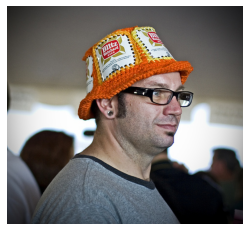

The man with pierced ears is wearing glasses and an orange hat.
A man in an orange hat starring at something.
A young child wearing a mask at Ivars.
A man wears an orange hat and glasses.
A man wearing a helmet and sunglasses smiles.


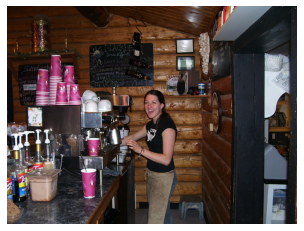

Four young teens having fun at a cookout.
Several ladies gathered around a table engaged in an electronics project
A woman standing with 3 other people in a store with two tables, some shelves with coffee and tea for sale, and a refrigerated drink case.
Several adults are filling their cups and a drink machine.
Two guys getting a drink at a store counter.


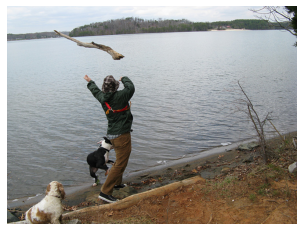

A man holds his dog near a pond.
A man is standing at edge of a pond, with two dogs and is throwing a branch is water.
A dog walks on a log across a small river.
A young boy plays in the water with the mountains in the background.
A man is throwing a big stick into the water so his two dogs and go fetch it.


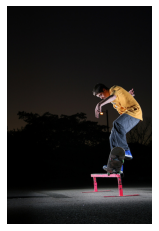

Man, skateboarding
A young adult is doing a back flip on a trampoline near a lake.
A young man hits a spectacular pose on a rail midair on his skateboard.
A man doing a trick on skateboard
A young boy is either jumping on a trampoline or skateboarding and he is serious about it on a beautiful summer day.


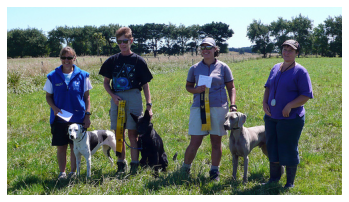

Four people holding three dogs in a field.
Four people stand with their dogs in a field.
These four people are standing outdoors, with 3 dogs.
A group of people stands by their dogs in a field.
The woman and three dogs are in a field.


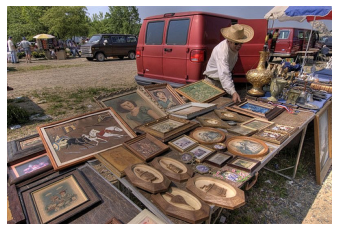

An old black man sitting in front of a white and blue shack.
A man is leaning over and pulling something out of a bag.
A man trimming a palm tree inside a patio-type cafe'.
A man in heavy clothing with a cart of tools bending to inspect the floor
An Asian man sits on the tracks with crates of peanuts.


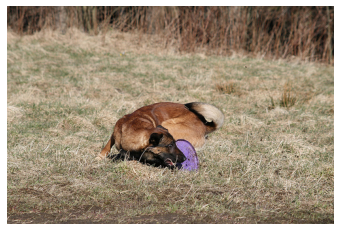

A brown dog waits for the Frisbee to come down before catching it.
A dog running in a park with a rubber chicken in its mouth.
A brown dog frolics in a field carrying a plush toy
A big black poodle running on the grass with a toy in its mouth.
A dog runs on the green grass near a wooden fence.


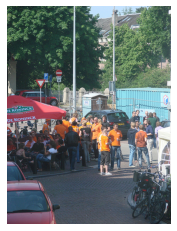

Travelers with lots of luggage standing in the middle of a large, empty city area.
People are driving scooters down the street at night.
There are a crowd of people standing on the side of the road with two cars beside them.
Two African american females ride on a moped down a city street that appears to be in a well congested area of a large city area.
Cars driving down a street lined with ornate walls and power lines.


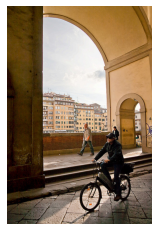

Two people on a bicycle are posing for a picture
Bicyclers riding over a bridge on a sunny day
A gentleman is riding his bike in the city.
A man on a bicycle pedals through an archway.
Four people are riding bicycles on a bike path near a busy street.


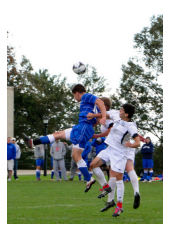

Two dirty guys playing soccer in the grass with players in the background.
Two boys practicing passing a soccer ball.
Three woman bouncing on balls in the grass.
Two males from the green team tackles the other members from black team for the ball in a game of rugby.
Three players bring a team opponent to the ground.


In [58]:
from PIL import Image
dataset_path = data_path / 'imgs'
query_images = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900]
img_out = "./results/task_d/retrieval"
for index in query_images:
    img_info = test_data[index]
    filename = img_info['filename']
    img= Image.open(dataset_path / filename)
    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    plt.show()
    for i in range(5):
        j = neighbors[index][i]
        img_id = j//5
        text_id = j%5
        text = test_data[img_id]['sentences'][text_id]['raw']
        print(text)
        
    